In [ ]:
!pip install ultralytics
!pip install onnx
!pip install onnxruntime-gpu

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 914.9/914.9 kB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 71.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 61.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 52.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 64.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
from ultralytics import YOLO
import cv2
import tqdm
import os
import numpy as np

# Initialisation du Drive
from google.colab import drive
drive.mount('/content/drive')

drive_path = '/content/drive/My Drive/'

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Mounted at /content/drive


In [ ]:
# Chargement du modèle ONNX exporté via le notebook train_model
model = YOLO(drive_path + "Computer Vision/Projet/model/model_v2.onnx")

WARNING ⚠️ Unable to automatically guess model task, assuming 'task=detect'. Explicitly define task for your model, i.e. 'task=detect', 'segment', 'classify','pose' or 'obb'.


In [ ]:
# Evaluation des métriques sur les données d'entraînement (i.e. performances en resubstitution)
metrics = model.val(
    data=drive_path + "Computer Vision/Projet/data/data.yaml",
    split='train',
    imgsz=736
    )

Ultralytics 8.3.75 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Loading /content/drive/My Drive/Computer Vision/Projet/model/model_v2.onnx for ONNX Runtime inference...
Using ONNX Runtime CUDAExecutionProvider
Setting batch=1 input of shape (1, 3, 736, 736)


val: Scanning /content/drive/.shortcut-targets-by-id/1IBh2XGF-9xpWoGhYCfeyyd1hyx8wcT1_/Computer Vision/Projet/data/train/labels.cache... 476 images, 0 backgrounds, 0 corrupt: 100%|██████████| 476/476 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 476/476 [00:27<00:00, 17.37it/s]


                   all        476       6493      0.929      0.972      0.985      0.857
                Bakery         34        308      0.944      0.948       0.98      0.837
              Biscuits         32        307      0.932      0.974      0.985      0.848
               Bombons         11         82      0.867      0.955      0.976      0.894
                Canned         37        766      0.946      0.958      0.986      0.862
               Cereals         21        176      0.931      0.977      0.977      0.871
                Cheese         36        497      0.944      0.981      0.985      0.857
                 Chips         18        239       0.92      0.954      0.971      0.733
                 Choco         15        147       0.96      0.982      0.993      0.897
                Coffee         38        392      0.934       0.99      0.989      0.897
                 Creme          7         87      0.939      0.989      0.993      0.882
    DriedFruitsAndNut

In [ ]:
print(metrics.box.map)    # mAP50-95
print(metrics.box.map50)  # mAP50
print(metrics.box.map75)  # mAP75

0.8572575146605184
0.9845767700878918
0.9748117165341248


In [ ]:
# Evaluation des métriques sur les données de validation (utilisée lors de l'entraînement). Les performances peuvent être légèrement différentes.
metrics = model.val(
    data=drive_path + "Computer Vision/Projet/data/data.yaml",
    split='val',
    imgsz=736,
    batch=8
    )

Ultralytics 8.3.75 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Loading /content/drive/My Drive/Computer Vision/Projet/model/model_v2.onnx for ONNX Runtime inference...
Using ONNX Runtime CUDAExecutionProvider
Setting batch=1 input of shape (1, 3, 736, 736)


100%|██████████| 755k/755k [00:00<00:00, 26.0MB/s]
val: Scanning /content/drive/.shortcut-targets-by-id/1IBh2XGF-9xpWoGhYCfeyyd1hyx8wcT1_/Computer Vision/Projet/data/valid/labels.cache... 102 images, 0 backgrounds, 0 corrupt: 100%|██████████| 102/102 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 102/102 [00:14<00:00,  6.93it/s]


                   all        102       1338      0.825      0.833        0.9      0.724
                Bakery          8         64      0.859      0.922      0.956      0.659
              Biscuits          8         68      0.826      0.985      0.977      0.812
               Bombons          4         26      0.774      0.922       0.94      0.718
                Canned          4         89      0.637      0.438      0.559      0.372
               Cereals          7         63      0.805      0.667      0.847      0.733
                Cheese          5         68      0.889      0.779      0.881      0.676
                 Chips          2         24      0.683          1      0.898        0.6
                 Choco          3         31      0.901          1      0.987        0.9
                Coffee          7         91      0.962      0.978      0.993      0.871
    DriedFruitsAndNuts          1          3      0.483          1      0.995      0.995
                IceTe

In [ ]:
print(metrics.box.map)    # mAP50-95
print(metrics.box.map50)  # mAP50
print(metrics.box.map75)  # mAP75

0.7239935921659356
0.8998101457571239
0.8128340392684269


In [ ]:
# Evaluation des métriques sur les données test
metrics = model.val(
    data=drive_path + "Computer Vision/Projet/data/data.yaml",
    split='test',
    imgsz=736
    )

Ultralytics 8.3.75 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Loading /content/drive/My Drive/Computer Vision/Projet/model/model_v2.onnx for ONNX Runtime inference...
Using ONNX Runtime CUDAExecutionProvider
Setting batch=1 input of shape (1, 3, 736, 736)


val: Scanning /content/drive/.shortcut-targets-by-id/1IBh2XGF-9xpWoGhYCfeyyd1hyx8wcT1_/Computer Vision/Projet/data/test/labels.cache... 102 images, 0 backgrounds, 0 corrupt: 100%|██████████| 102/102 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 102/102 [00:05<00:00, 17.05it/s]


                   all        102       1341      0.807      0.834      0.848      0.694
                Bakery         13         96      0.821      0.812      0.831      0.592
              Biscuits          5         59      0.905      0.972       0.98      0.748
               Bombons          4         26      0.527      0.962      0.642      0.496
                Canned          7        127      0.903       0.89      0.934      0.805
               Cereals          3         54      0.923      0.668      0.835      0.684
                Cheese          9        100      0.877      0.923      0.942       0.75
                 Chips          5         78       0.79      0.923      0.929      0.593
                 Choco          1          6      0.494          1      0.872       0.78
                Coffee         10        127      0.935      0.911      0.956      0.839
                 Creme          1         21      0.887      0.905      0.962      0.767
    DriedFruitsAndNut

In [ ]:
print(metrics.box.map)    # mAP50-95
print(metrics.box.map50)  # mAP50
print(metrics.box.map75)  # mAP75

0.6938566194014268
0.8477818198964989
0.8010128955209271


Loading /content/drive/My Drive/Computer Vision/Projet/model/model_v2.onnx for ONNX Runtime inference...
Using ONNX Runtime CUDAExecutionProvider

0: 736x736 15 Canneds, 23 Cerealss, 3 Pastas, 71.5ms
Speed: 109.5ms preprocess, 71.5ms inference, 751.6ms postprocess per image at shape (1, 3, 736, 736)


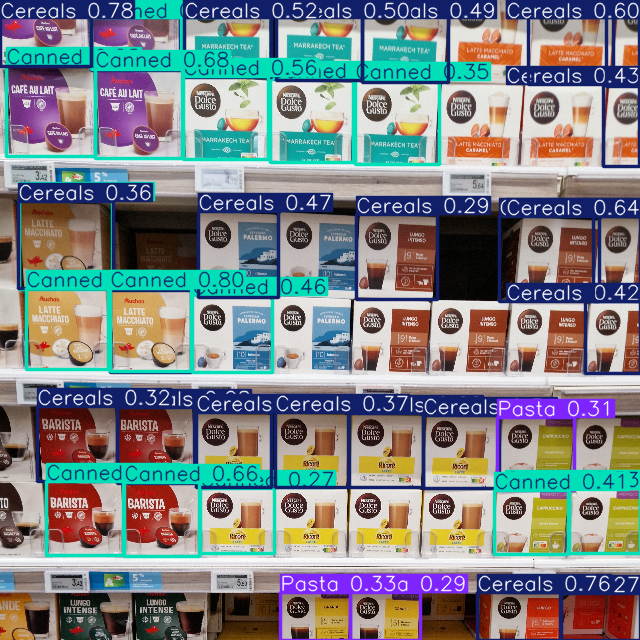


0: 736x736 2 Biscuitss, 7 Canneds, 10 Cerealss, 3 Pastas, 68.7ms
Speed: 7.3ms preprocess, 68.7ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


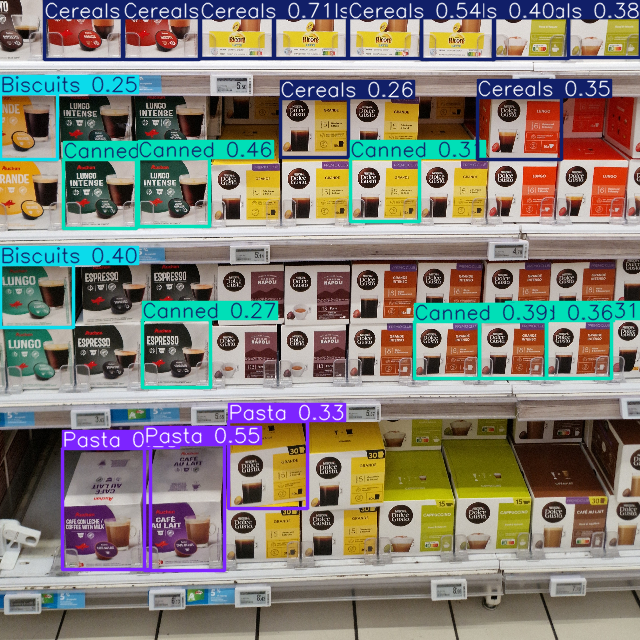


0: 736x736 13 Bakerys, 69.0ms
Speed: 8.1ms preprocess, 69.0ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


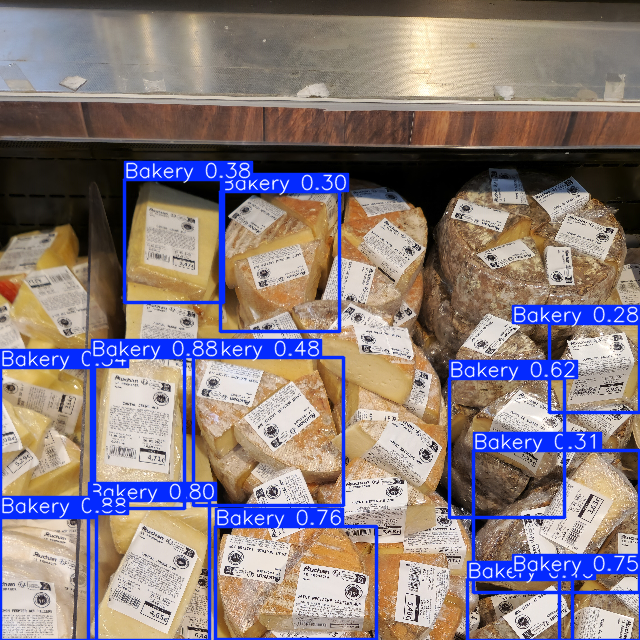


0: 736x736 13 Bakerys, 68.7ms
Speed: 5.3ms preprocess, 68.7ms inference, 1.6ms postprocess per image at shape (1, 3, 736, 736)


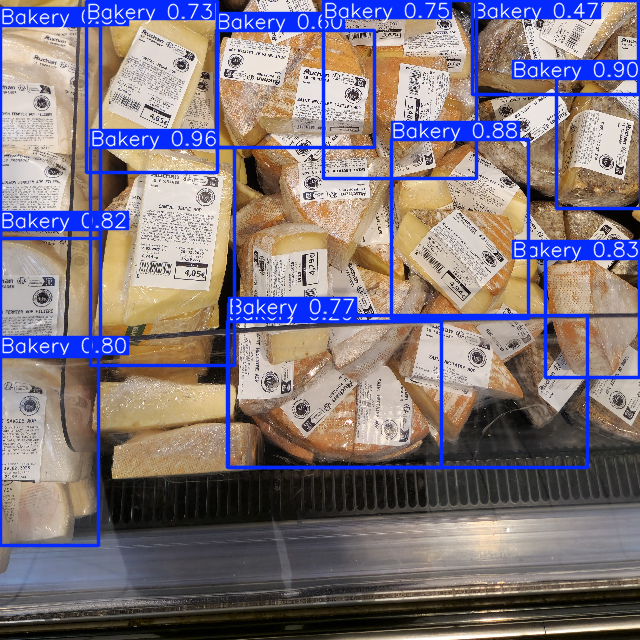


0: 736x736 24 Cerealss, 3 Pastas, 70.6ms
Speed: 9.9ms preprocess, 70.6ms inference, 1.7ms postprocess per image at shape (1, 3, 736, 736)


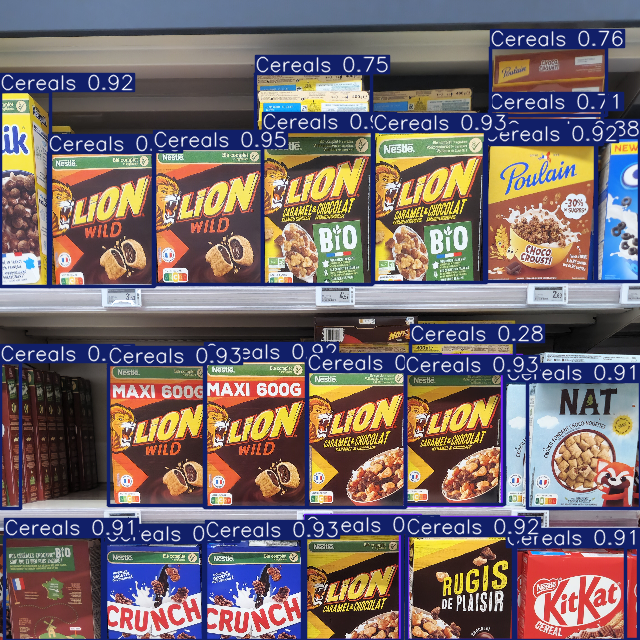


0: 736x736 28 Cerealss, 70.0ms
Speed: 7.4ms preprocess, 70.0ms inference, 2.7ms postprocess per image at shape (1, 3, 736, 736)


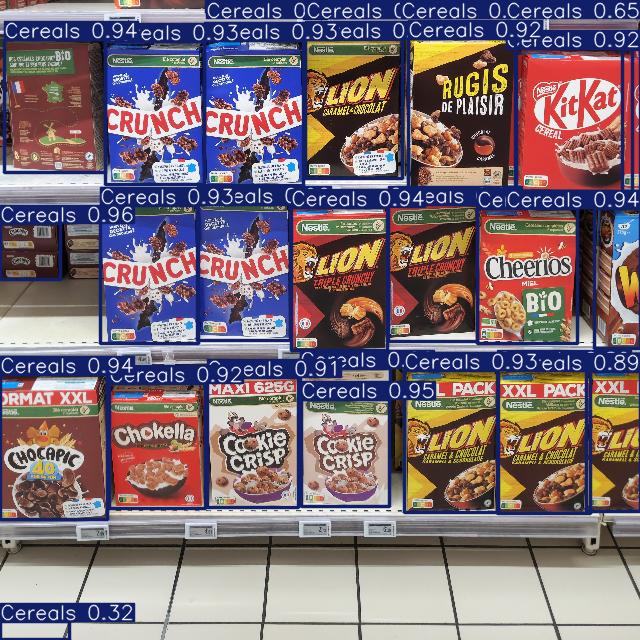


0: 736x736 1 Cereals, 1 Choco, 46 Rices, 1 Snacks, 69.4ms
Speed: 5.6ms preprocess, 69.4ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


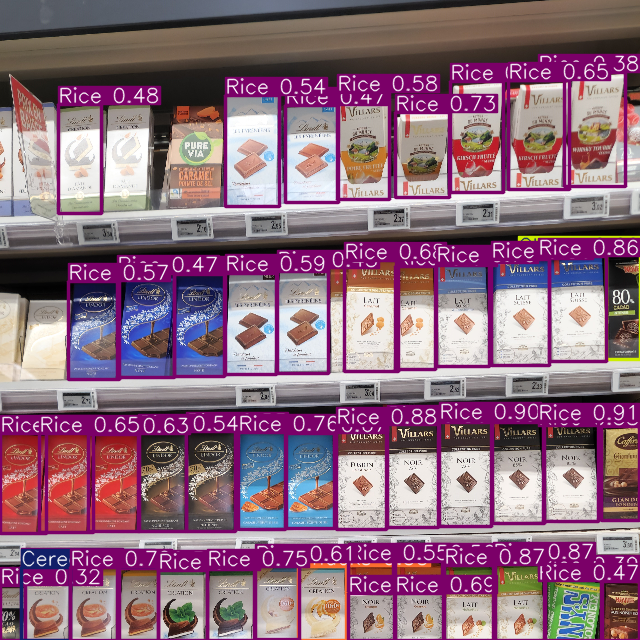


0: 736x736 17 Cerealss, 1 Choco, 50 Rices, 70.2ms
Speed: 7.0ms preprocess, 70.2ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


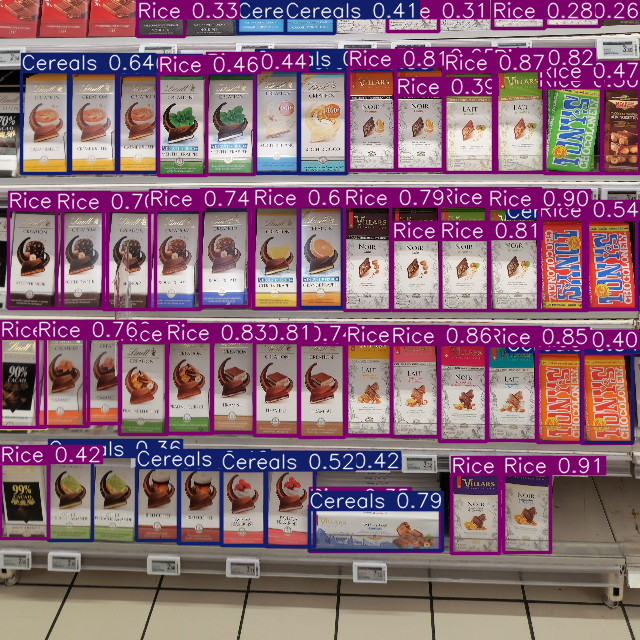


0: 736x736 8 Cerealss, 20 Snackss, 69.5ms
Speed: 7.1ms preprocess, 69.5ms inference, 2.1ms postprocess per image at shape (1, 3, 736, 736)


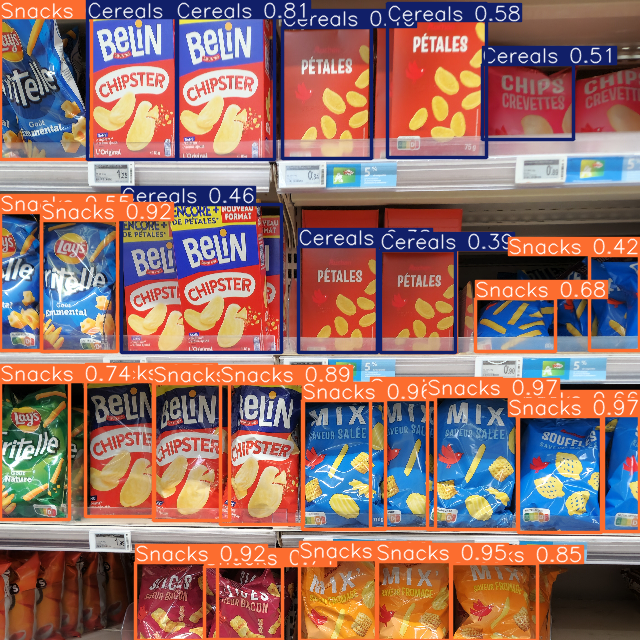


0: 736x736 28 Bombonss, 10 Snackss, 71.7ms
Speed: 5.8ms preprocess, 71.7ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


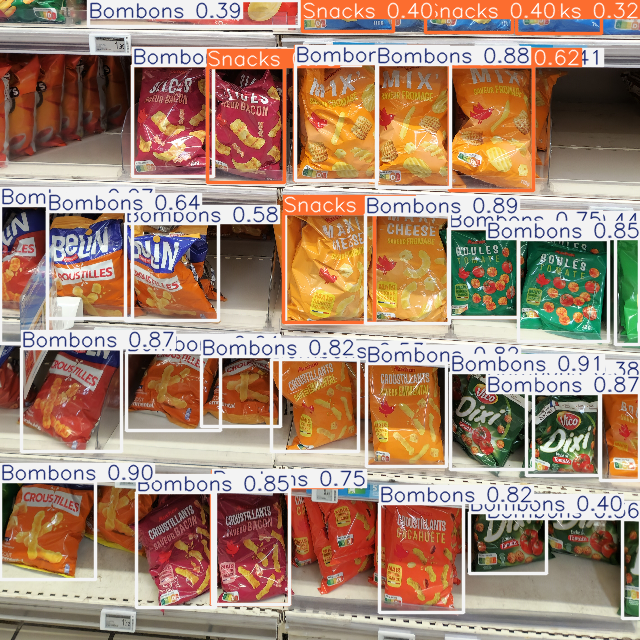


0: 736x736 1 Cereals, 2 Coffees, 26 Snackss, 72.0ms
Speed: 6.4ms preprocess, 72.0ms inference, 2.1ms postprocess per image at shape (1, 3, 736, 736)


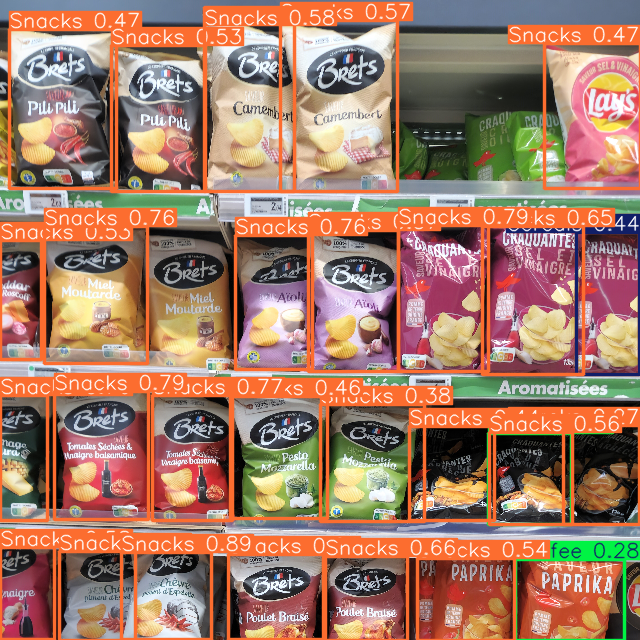


0: 736x736 24 Cerealss, 8 Pastas, 9 Snackss, 70.0ms
Speed: 6.7ms preprocess, 70.0ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


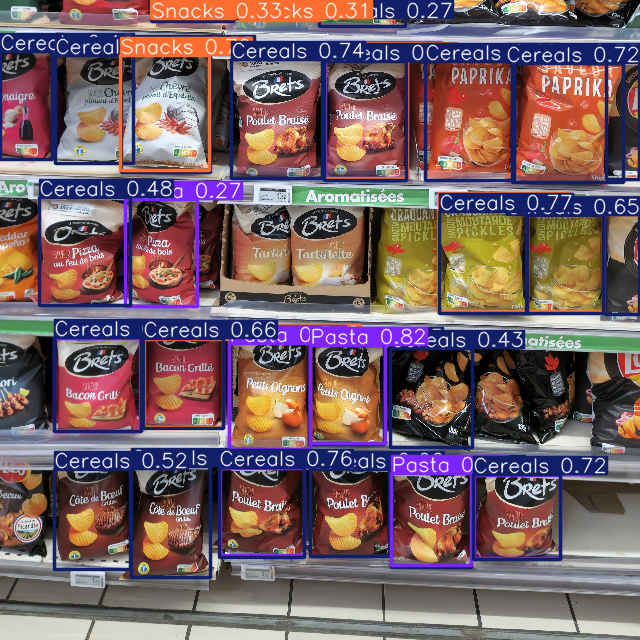


0: 736x736 52 SoftDrinkss, 69.1ms
Speed: 6.2ms preprocess, 69.1ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


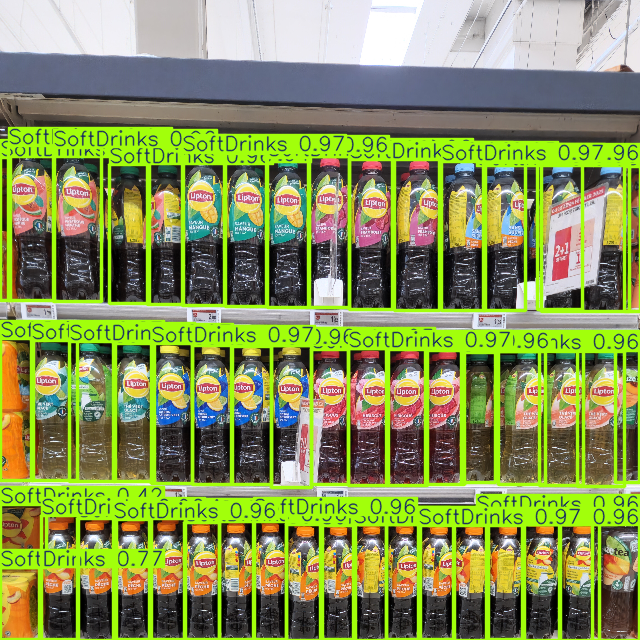


0: 736x736 54 SoftDrinkss, 75.0ms
Speed: 6.5ms preprocess, 75.0ms inference, 7.5ms postprocess per image at shape (1, 3, 736, 736)


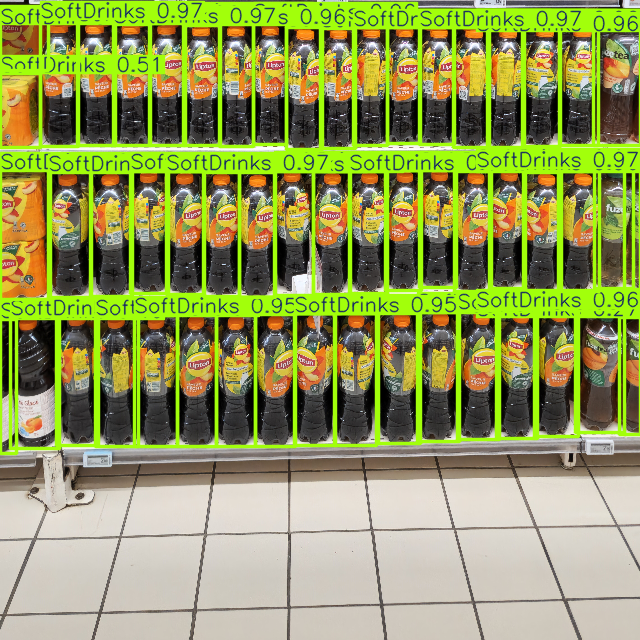


0: 736x736 48 Juicess, 69.7ms
Speed: 5.8ms preprocess, 69.7ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


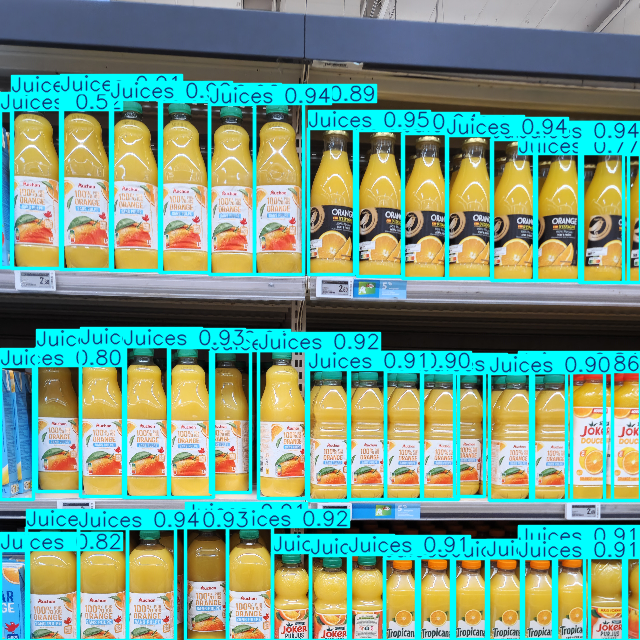


0: 736x736 44 Juicess, 69.0ms
Speed: 6.2ms preprocess, 69.0ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


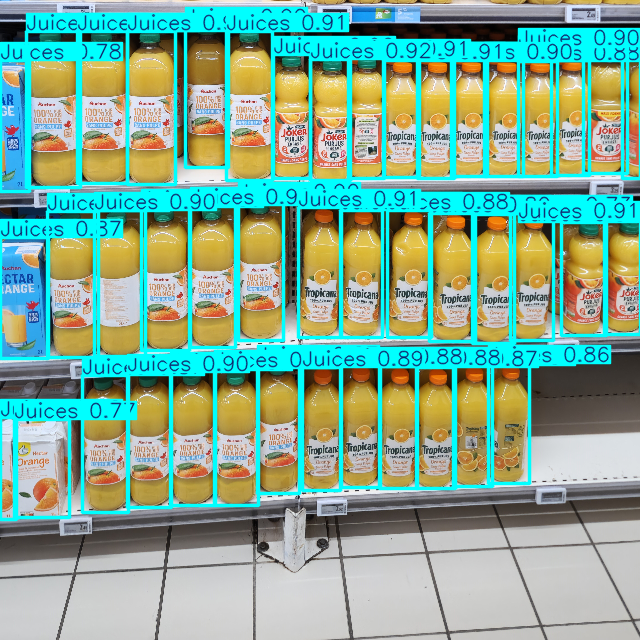


0: 736x736 1 Juices, 7 Milks, 69.8ms
Speed: 6.1ms preprocess, 69.8ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


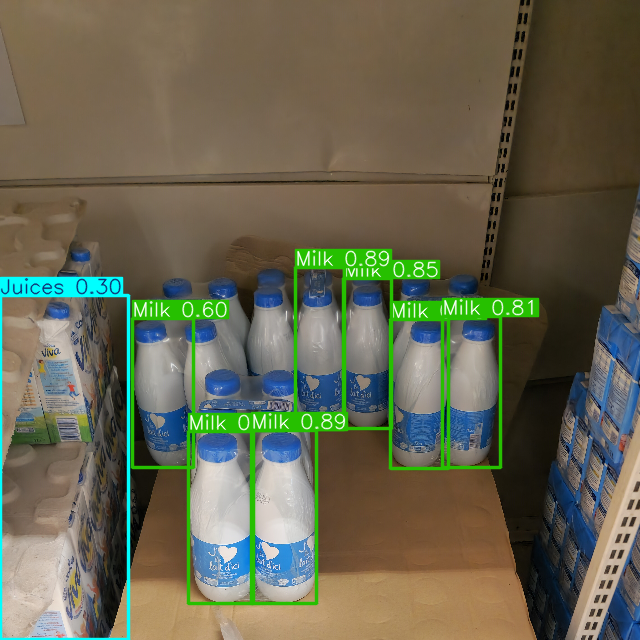


0: 736x736 4 Bakerys, 3 Pastas, 69.8ms
Speed: 7.7ms preprocess, 69.8ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


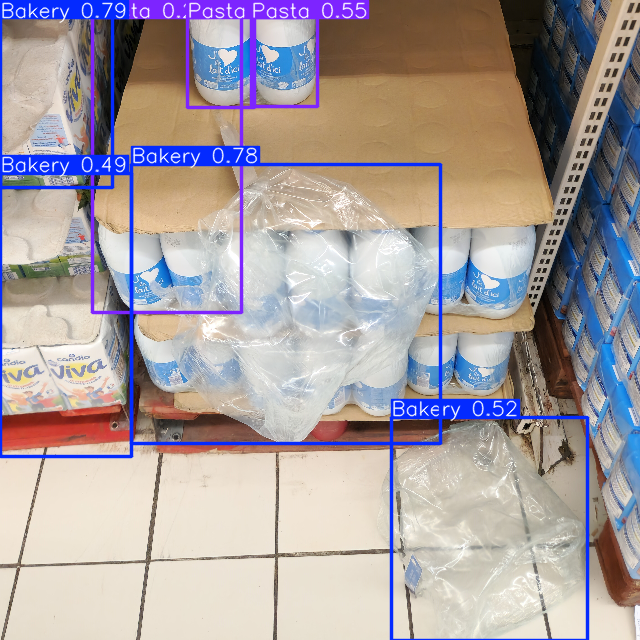


0: 736x736 2 Bombonss, 1 Snacks, 2 Waters, 69.9ms
Speed: 5.7ms preprocess, 69.9ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


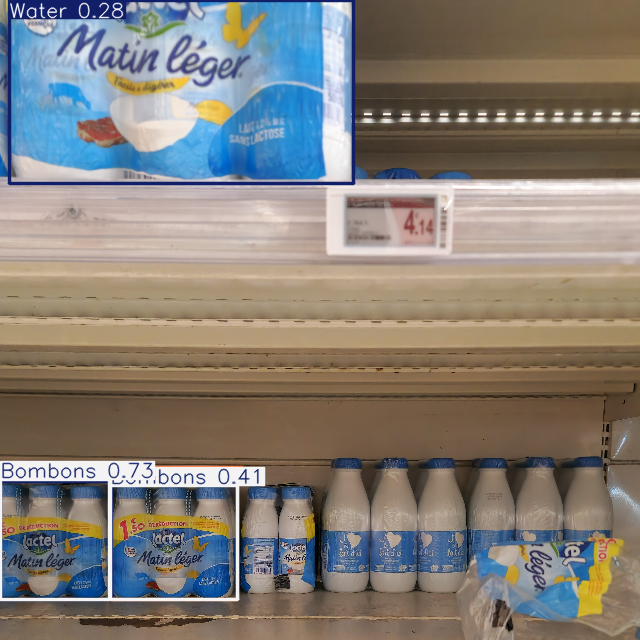


0: 736x736 17 Milks, 1 Water, 69.5ms
Speed: 6.3ms preprocess, 69.5ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


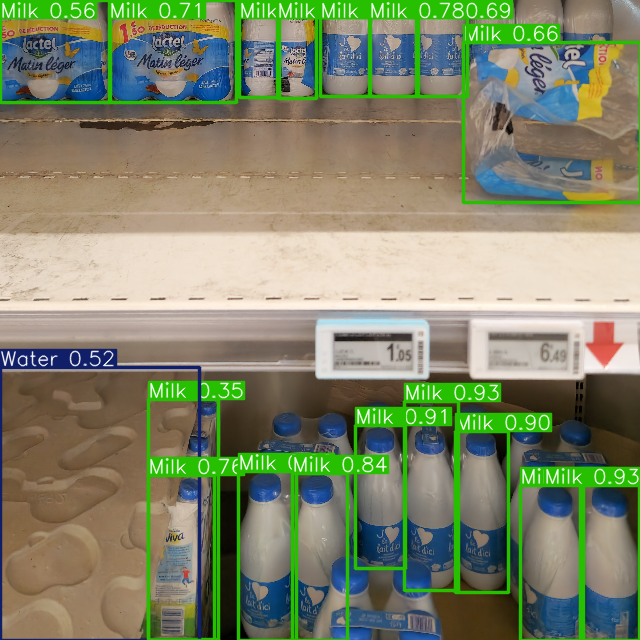


0: 736x736 44 Pastas, 70.3ms
Speed: 5.3ms preprocess, 70.3ms inference, 2.0ms postprocess per image at shape (1, 3, 736, 736)


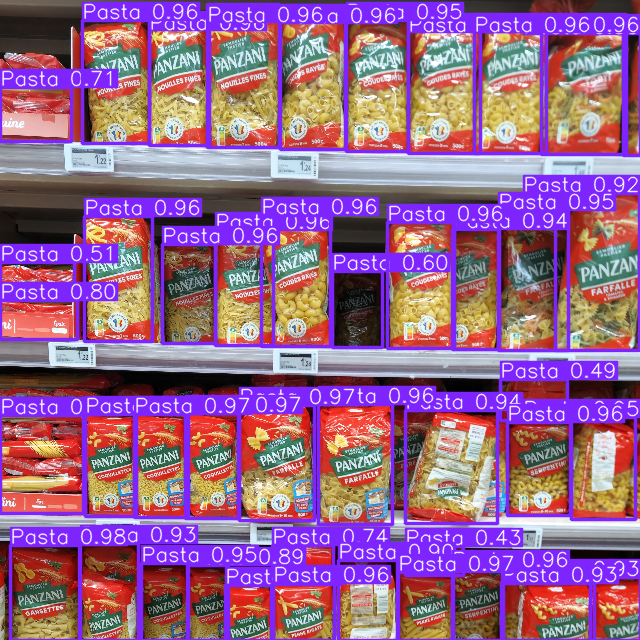


0: 736x736 49 Pastas, 72.5ms
Speed: 5.3ms preprocess, 72.5ms inference, 2.2ms postprocess per image at shape (1, 3, 736, 736)


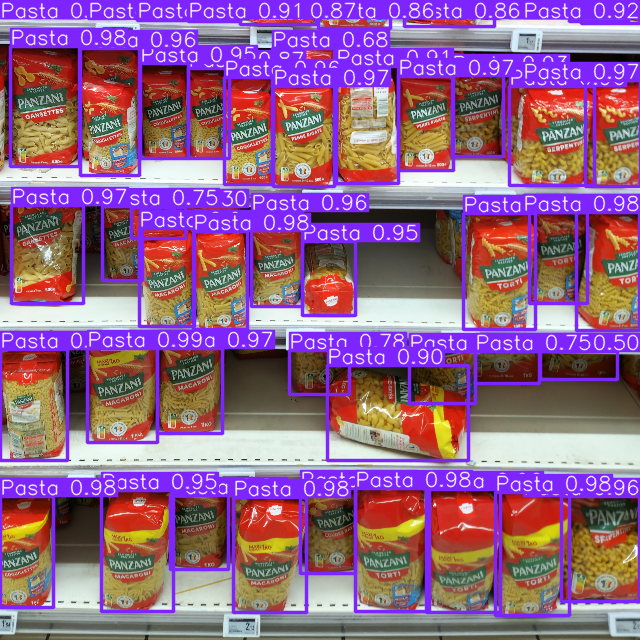


0: 736x736 23 Cerealss, 11 Pastas, 1 Rice, 13 Snackss, 75.5ms
Speed: 6.0ms preprocess, 75.5ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


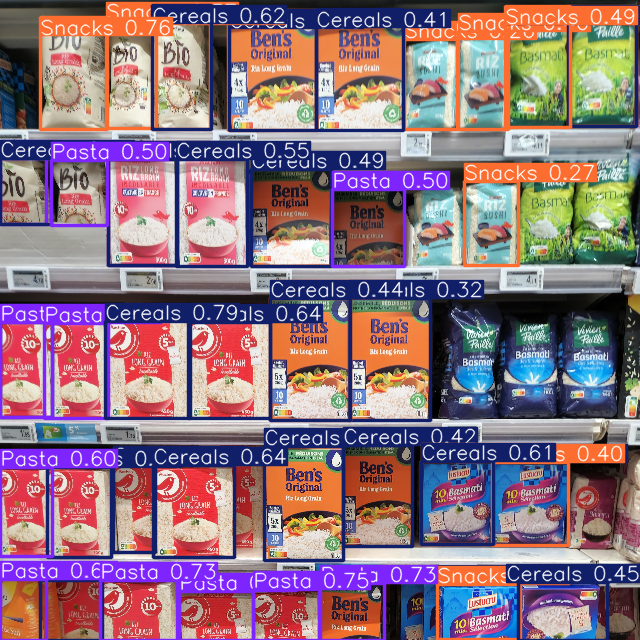


0: 736x736 19 Cerealss, 30 Pastas, 3 Snackss, 69.3ms
Speed: 5.7ms preprocess, 69.3ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


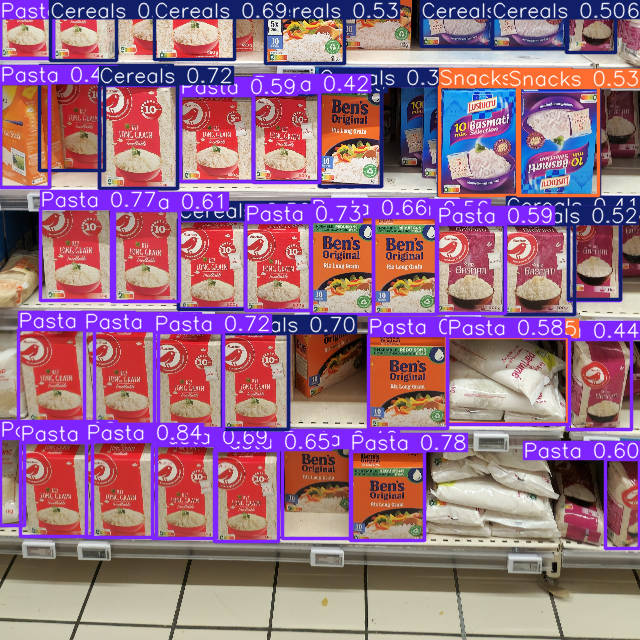


0: 736x736 84 Cheeses, 2 Yoghurts, 4 chocolates, 74.7ms
Speed: 7.3ms preprocess, 74.7ms inference, 4.7ms postprocess per image at shape (1, 3, 736, 736)


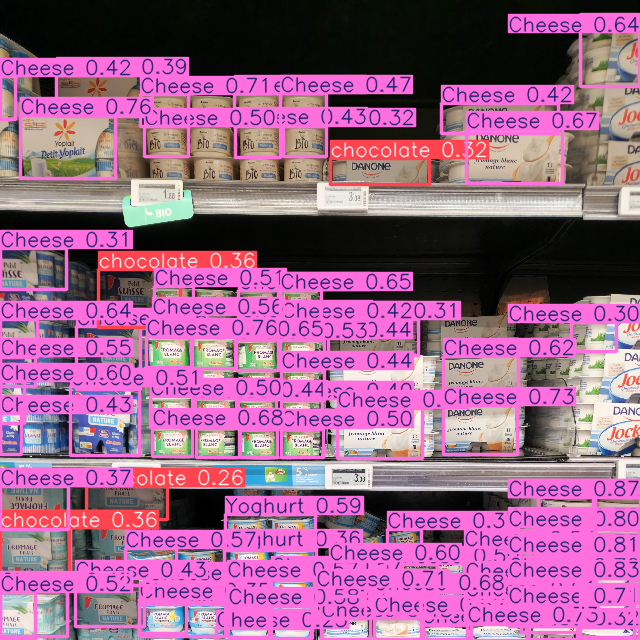


0: 736x736 57 Cheeses, 13 Yoghurts, 71.2ms
Speed: 5.4ms preprocess, 71.2ms inference, 2.6ms postprocess per image at shape (1, 3, 736, 736)


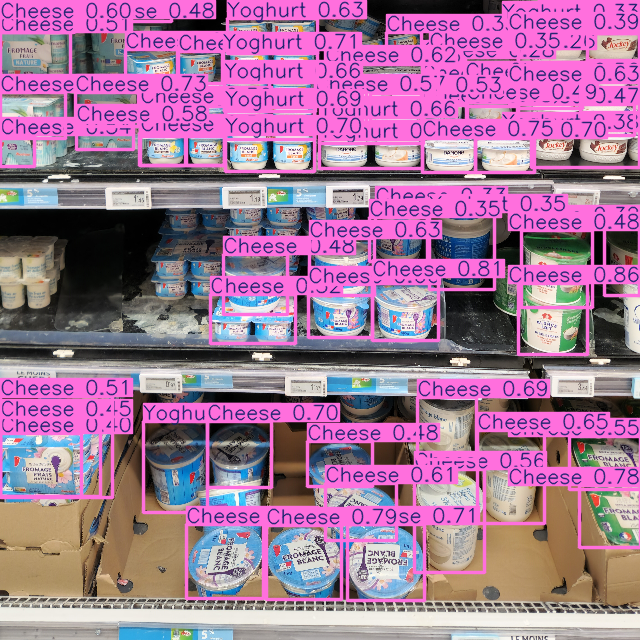


0: 736x736 1 Biscuits, 3 Cheeses, 24 Yoghurts, 69.3ms
Speed: 7.8ms preprocess, 69.3ms inference, 1.7ms postprocess per image at shape (1, 3, 736, 736)


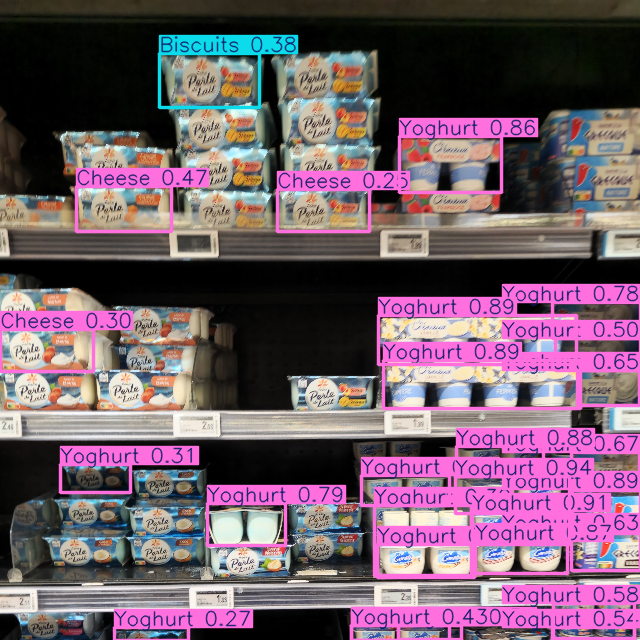


0: 736x736 1 Canned, 2 Cerealss, 14 Cheeses, 7 Yoghurts, 74.0ms
Speed: 8.5ms preprocess, 74.0ms inference, 2.0ms postprocess per image at shape (1, 3, 736, 736)


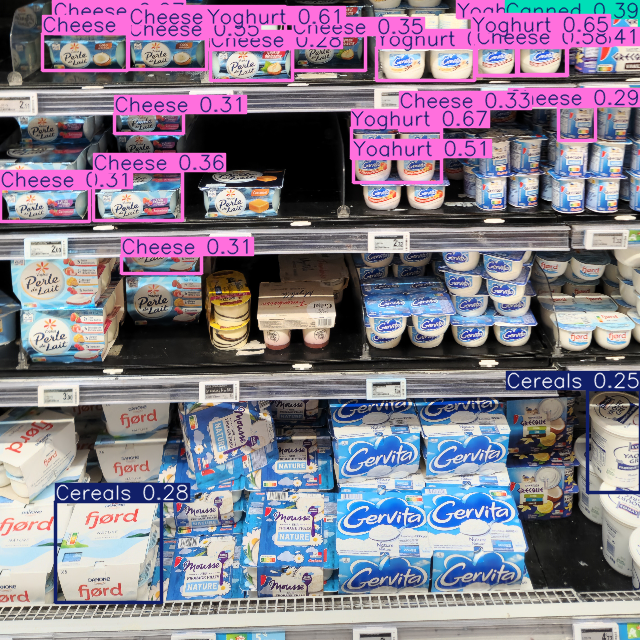


0: 736x736 19 Bakerys, 69.5ms
Speed: 6.5ms preprocess, 69.5ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


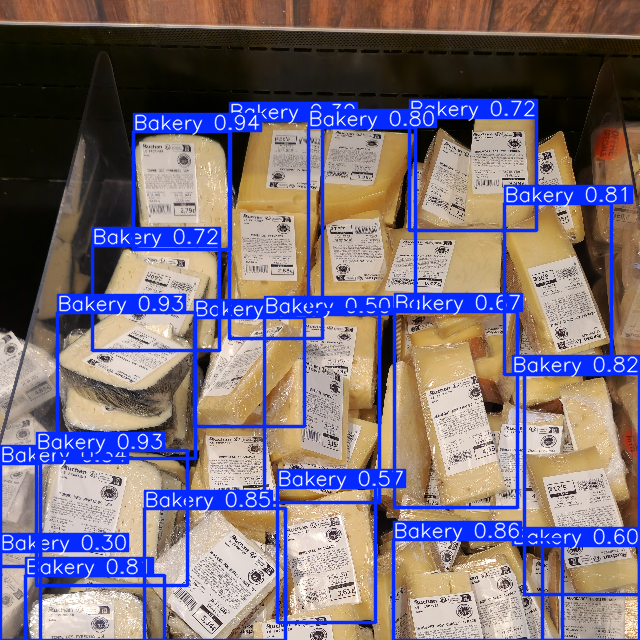


0: 736x736 13 Bakerys, 69.8ms
Speed: 5.5ms preprocess, 69.8ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


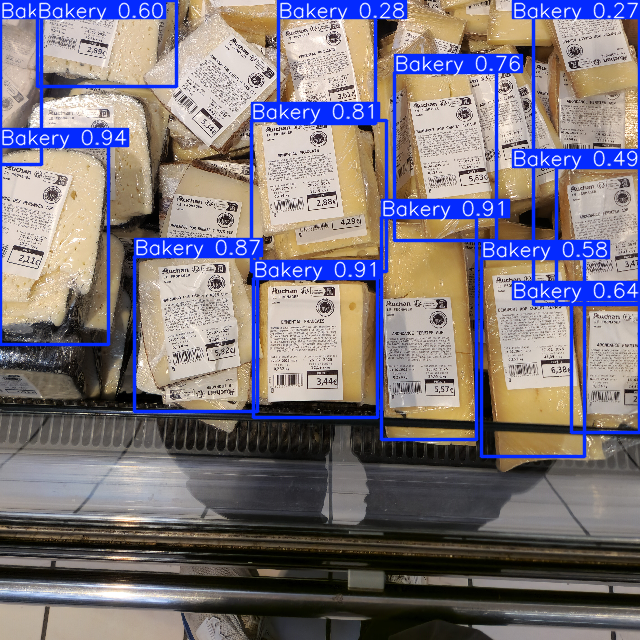


0: 736x736 1 Bombons, 69.8ms
Speed: 7.3ms preprocess, 69.8ms inference, 3.1ms postprocess per image at shape (1, 3, 736, 736)


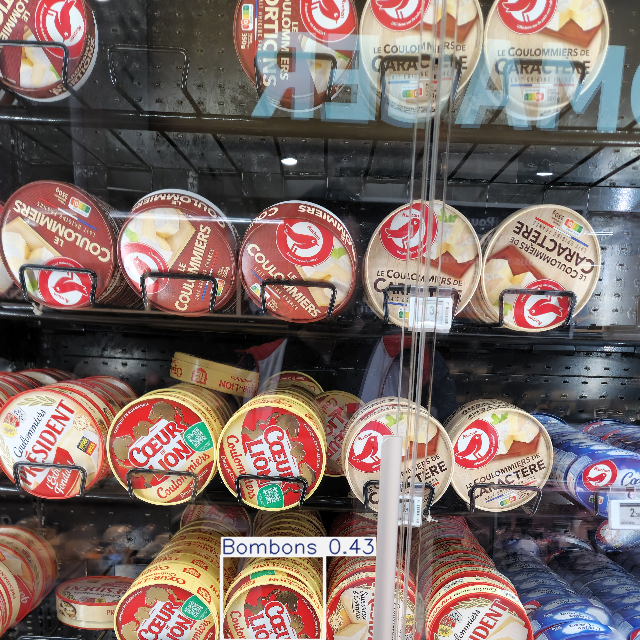


0: 736x736 4 Waters, 74.2ms
Speed: 5.6ms preprocess, 74.2ms inference, 2.2ms postprocess per image at shape (1, 3, 736, 736)


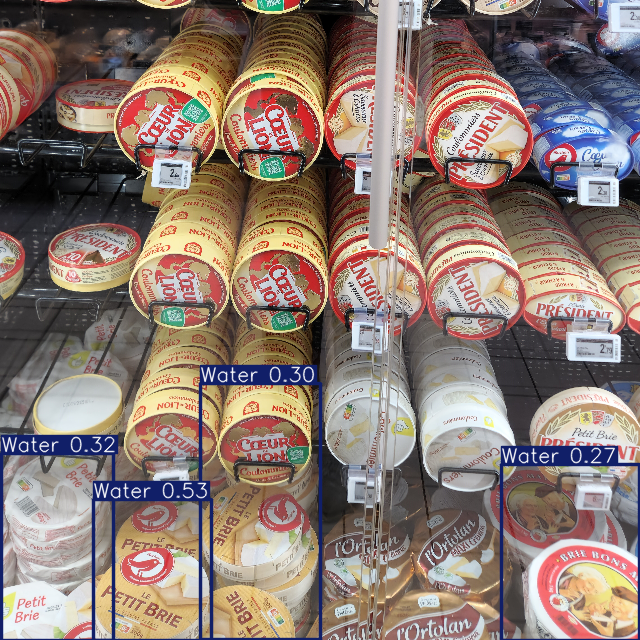


0: 736x736 5 Canneds, 1 Coffee, 36 Waters, 72.3ms
Speed: 5.4ms preprocess, 72.3ms inference, 2.7ms postprocess per image at shape (1, 3, 736, 736)


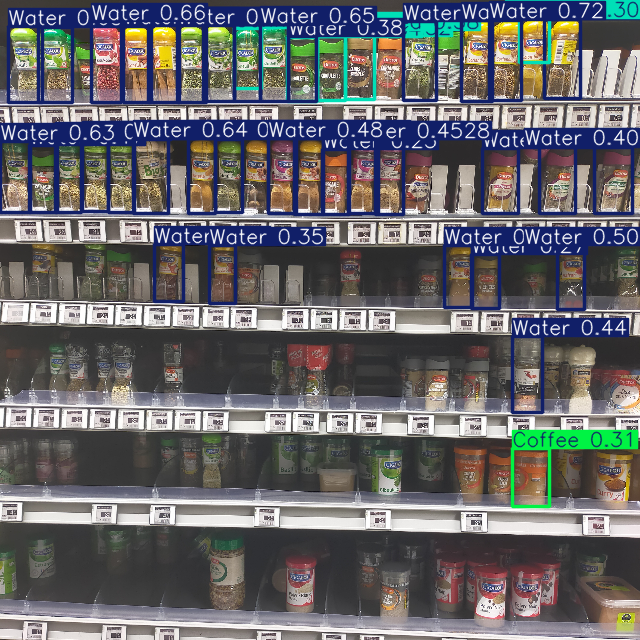


0: 736x736 1 Choco, 1 Coffee, 1 Milk, 1 Yoghurt, 69.8ms
Speed: 5.7ms preprocess, 69.8ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


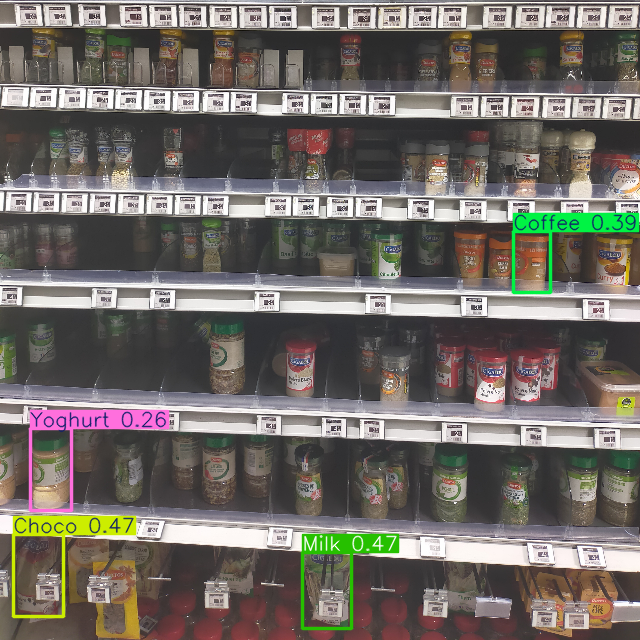


0: 736x736 2 Chocos, 1 Creme, 3 Waters, 7 chocolates, 69.6ms
Speed: 5.7ms preprocess, 69.6ms inference, 2.1ms postprocess per image at shape (1, 3, 736, 736)


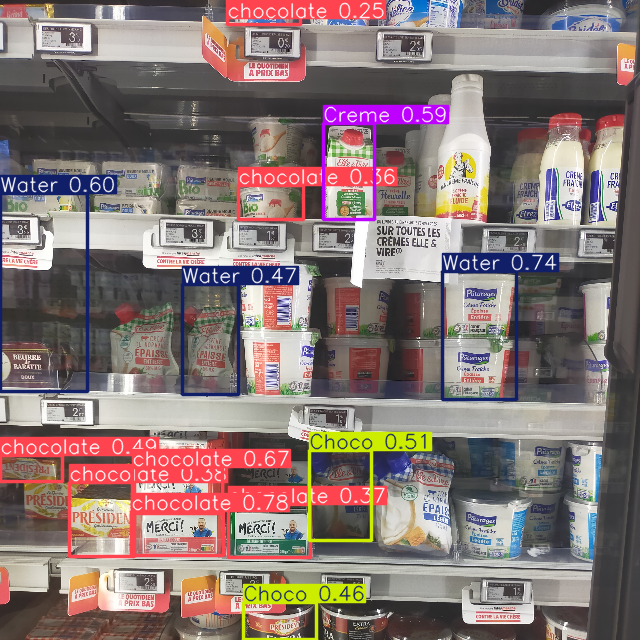


0: 736x736 1 Bombons, 2 Chocos, 1 Sauce, 3 Yoghurts, 10 chocolates, 70.2ms
Speed: 5.7ms preprocess, 70.2ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


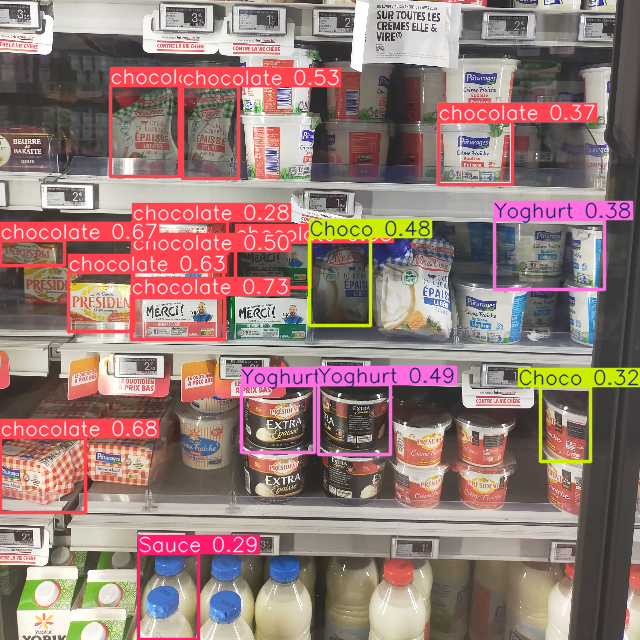


0: 736x736 43 Oil-Vinegars, 69.1ms
Speed: 5.6ms preprocess, 69.1ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


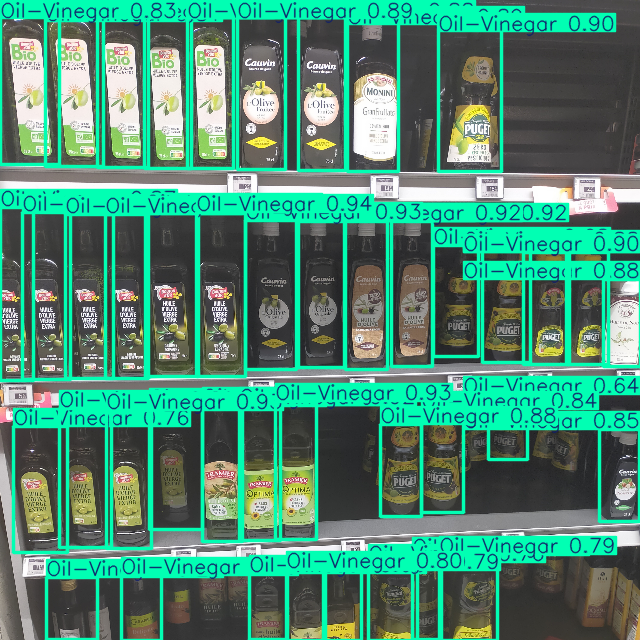


0: 736x736 43 Oil-Vinegars, 69.8ms
Speed: 6.0ms preprocess, 69.8ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


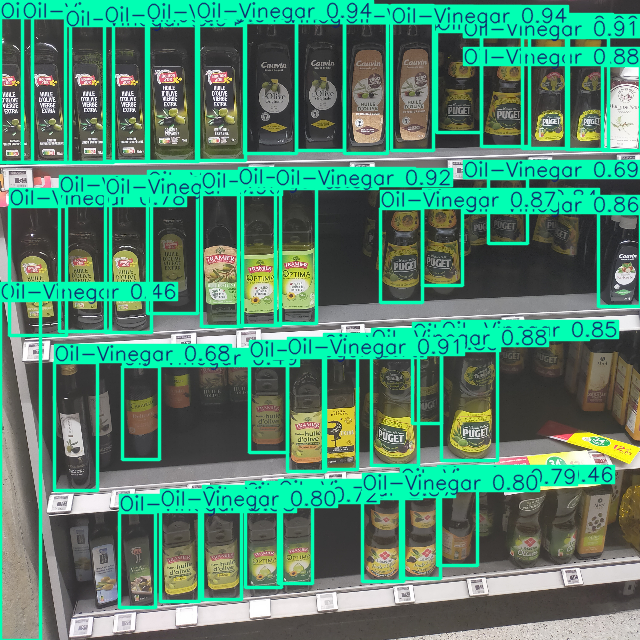


0: 736x736 3 Cerealss, 5 Pastas, 33 Snackss, 70.2ms
Speed: 5.6ms preprocess, 70.2ms inference, 1.8ms postprocess per image at shape (1, 3, 736, 736)


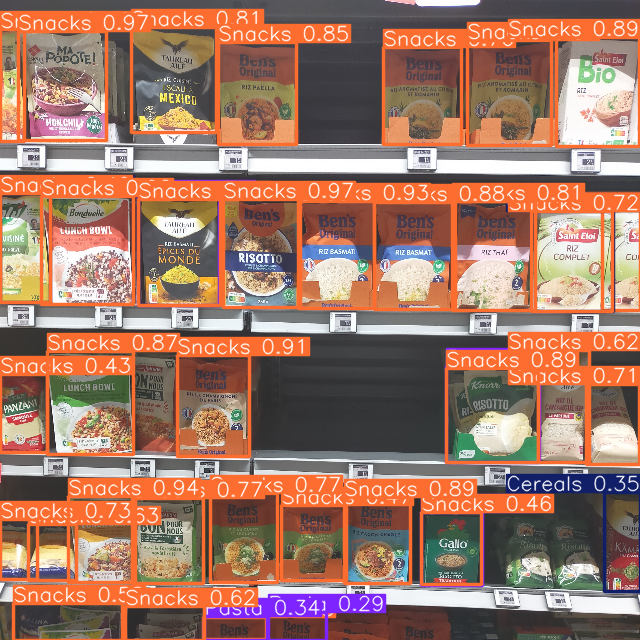


0: 736x736 9 Cerealss, 4 Pastas, 1 Rice, 30 Snackss, 69.3ms
Speed: 5.5ms preprocess, 69.3ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


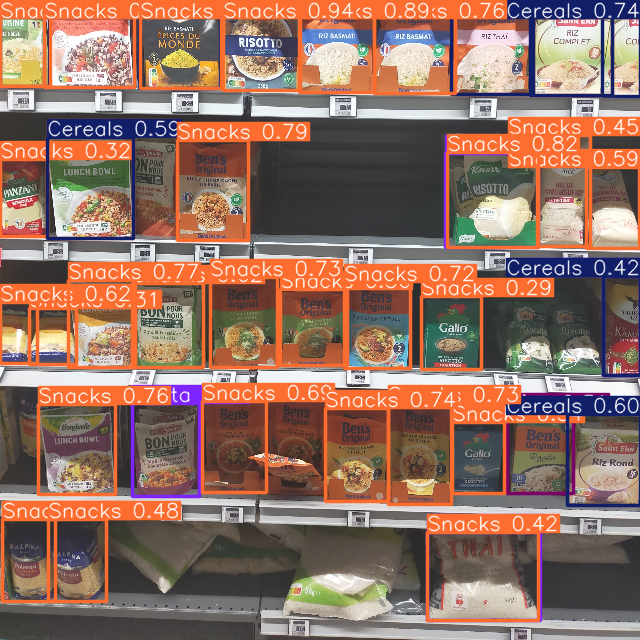


0: 736x736 79 Canneds, 1 Soups, 71.0ms
Speed: 5.6ms preprocess, 71.0ms inference, 2.5ms postprocess per image at shape (1, 3, 736, 736)


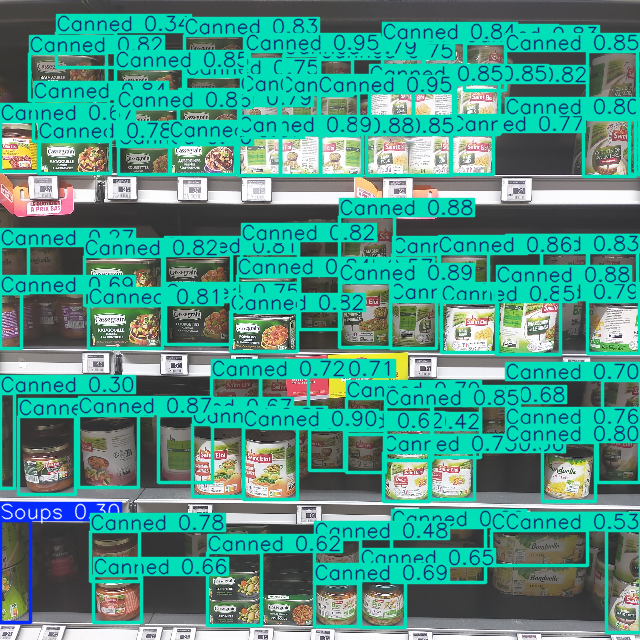


0: 736x736 50 Canneds, 1 Soups, 69.4ms
Speed: 14.5ms preprocess, 69.4ms inference, 2.0ms postprocess per image at shape (1, 3, 736, 736)


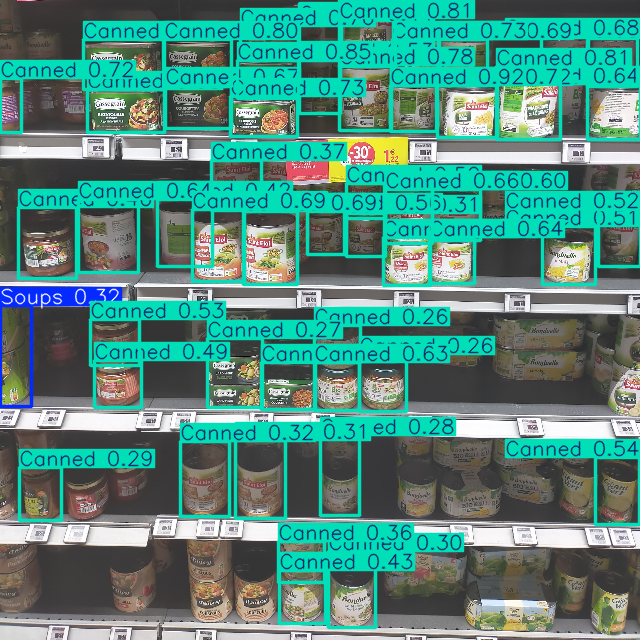


0: 736x736 39 Bombonss, 1 Water, 75.3ms
Speed: 5.5ms preprocess, 75.3ms inference, 6.0ms postprocess per image at shape (1, 3, 736, 736)


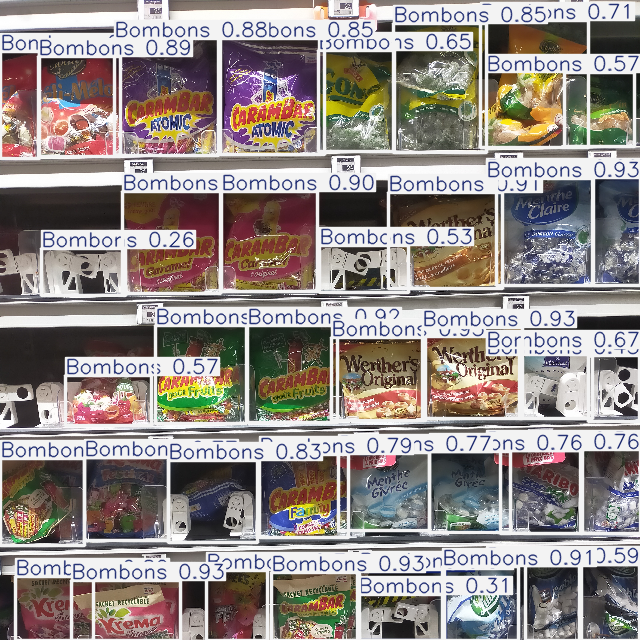


0: 736x736 2 Bakerys, 25 Bombonss, 4 Waters, 1 Yoghurt, 74.3ms
Speed: 6.2ms preprocess, 74.3ms inference, 1.9ms postprocess per image at shape (1, 3, 736, 736)


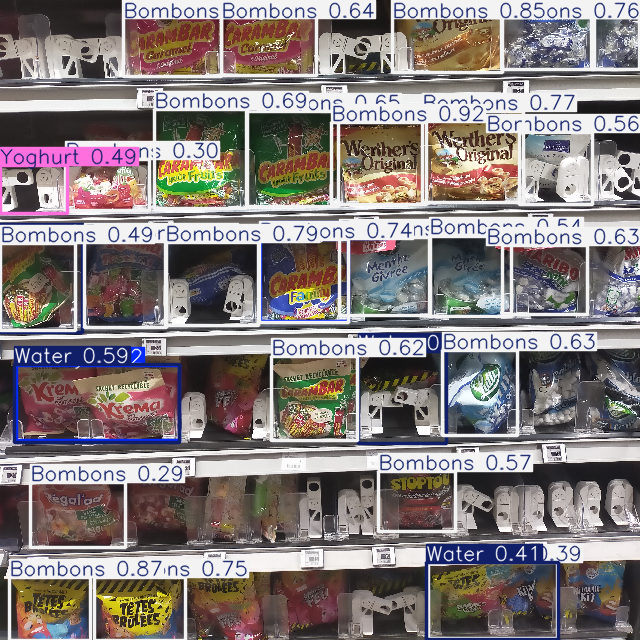


0: 736x736 60 Canneds, 12 IceTeas, 10 Oil-Vinegars, 3 SoftDrinkss, 80.6ms
Speed: 7.7ms preprocess, 80.6ms inference, 2.0ms postprocess per image at shape (1, 3, 736, 736)


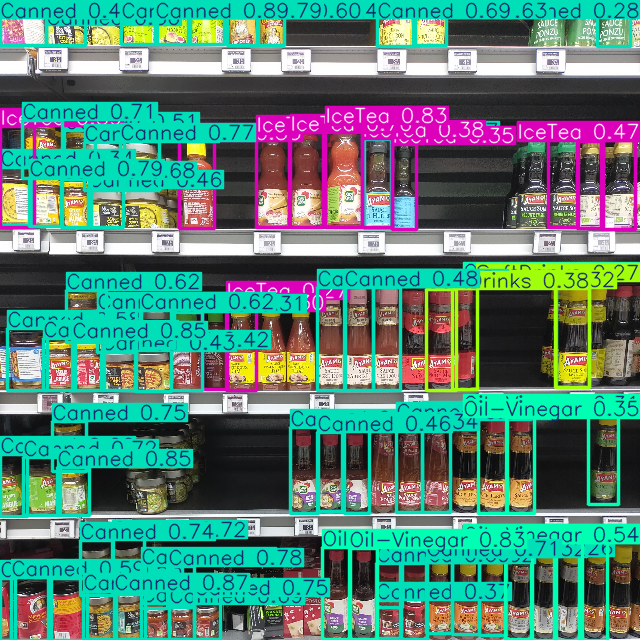


0: 736x736 51 Canneds, 2 IceTeas, 35 Oil-Vinegars, 3 Sauces, 69.0ms
Speed: 5.7ms preprocess, 69.0ms inference, 2.1ms postprocess per image at shape (1, 3, 736, 736)


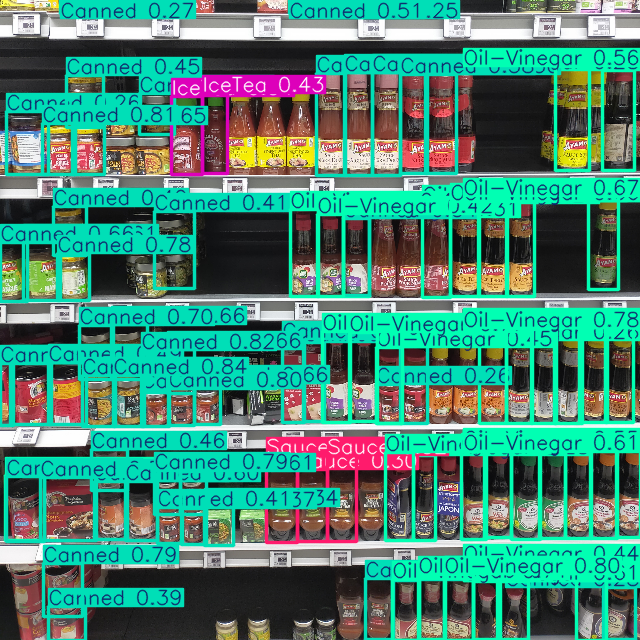

In [ ]:
# Photos d'un supermarché français
import os

# Spécifiez le chemin du dossier
folder = folder_path = drive_path + "Computer Vision/Projet/images"

# Parcourez les fichiers du dossier
for nom_fichier in os.listdir(folder): # 46 images
    # Vérifiez si l'élément est un fichier (et non un sous-dossier)
    if os.path.isfile(os.path.join(folder, nom_fichier)):
        # Application sur nouvelles images
        img = cv2.imread(os.path.join(folder,nom_fichier))
        resized_img = cv2.resize(img, (640,640))
        res = model(
            source=resized_img,
            imgsz=736
            )

        res[0].show()
        res[0].save(os.path.join(folder, "..","images_pred",nom_fichier))